### Refugee Movement Around the World Analysis

https://github.com/rfordatascience/tidytuesday/blob/master/data/2023/2023-08-22/readme.md

In [1]:
import neo4j
import pandas as pd
from IPython.display import display, Image
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# Read in UN refugees data
population = pd.read_csv('population.csv')

In [3]:
# Import ISO country codes in order to map continents
country_code_mappings = pd.read_csv('country_code_mappings.csv')
country_continent_df = country_code_mappings[['alpha-3', 'region']].set_index('alpha-3')
country_continent_dict = dict(zip(country_continent_df.index, country_continent_df['region']))
population['coo_continent'] = population['coo_iso'].map(country_continent_dict)
population['coa_continent'] = population['coa_iso'].map(country_continent_dict)

### Get overall refugee and asylum seeker counts across years per country & continent

In [40]:
# Filter to population of interest (having refugees, where coo <> coa)
population2 = population[population['refugees'] > 0]
population3 = population2[population2['coo'] != population2['coa']]

# Map country three letter codes to names (e.g., USA == United States of America) 
origin_country_dict = dict(zip(population['coo'], population['coo_name']))
asylum_country_dict = dict(zip(population['coa'], population['coa_name']))
country_name_dict = origin_country_dict | asylum_country_dict
print(f'{len(country_name_dict)} unique countries in dataset, with \
{len(country_name_dict)} origin and {len(asylum_country_dict)} asylum.')

212 unique countries in dataset, with 212 origin and 189 asylum.


In [41]:
# Groupby to get overall refugee and asylum seeker counts per country
country_gb = population3.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()
country_gb.reset_index(inplace=True)
country_gb.head()

/tmp/ipykernel_121/827640204.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  country_gb = population3.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()


,coo,coa,refugees,asylum_seekers
0,AFG,ALB,19,0
1,AFG,ARE,203,529
2,AFG,ARG,72,28
3,AFG,ARM,24,0
4,AFG,AUL,113114,20090


In [169]:
# Groupby with subset of years (2011-2015) to examine first few years of Syrian crisis
population4 = population3[(population3['year'] >= 2011) & (population3['year'] <= 2015)]
country_gb2 = population4.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()
country_gb2.reset_index(inplace=True)
country_gb2.head()

/tmp/ipykernel_121/1959731501.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  country_gb2 = population4.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()


,coo,coa,refugees,asylum_seekers
0,AFG,ARG,10,0
1,AFG,AUL,35846,4906
2,AFG,AUS,62951,41294
3,AFG,AZE,3105,561
4,AFG,BEL,14352,6664


In [70]:
# Groupby to get overall refugee and asylum seeker counts per continent
continent_gb = population3.groupby(['coo_continent', 'coa_continent'])['refugees', 'asylum_seekers'].sum()
continent_gb.reset_index(inplace=True)
continent_gb = continent_gb[continent_gb['coo_continent'] != continent_gb['coa_continent']]
continents = continent_gb['coo_continent'].unique()
continent_gb

/tmp/ipykernel_121/3648867582.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  continent_gb = population3.groupby(['coo_continent', 'coa_continent'])['refugees', 'asylum_seekers'].sum()


,coo_continent,coa_continent,refugees,asylum_seekers
1,Africa,Americas,1243498,925982
2,Africa,Asia,3225455,409756
3,Africa,Europe,6129978,2267045
4,Africa,Oceania,60063,29470
5,Americas,Africa,45,0
7,Americas,Asia,93,216
8,Americas,Europe,535711,546119
9,Americas,Oceania,3501,5531
10,Asia,Africa,3174717,540408
11,Asia,Americas,2346161,1828541


#### Connect, login, create driver, create session; with community edition, we can only use 1 database, the "neo4j" database

In [6]:
driver = neo4j.GraphDatabase.driver(uri="neo4j://neo4j:7687", auth=("neo4j","ucb_mids_w205"))

In [7]:
session = driver.session(database="neo4j")

#### Functions to Manage neo4j data

In [8]:
def my_neo4j_wipe_out_database():
    "wipe out database by deleting all nodes and relationships"
    
    query = "match (node)-[relationship]->() delete node, relationship"
    session.run(query)
    
    query = "match (node) delete node"
    session.run(query)

In [9]:
def my_neo4j_run_query_pandas(query, **kwargs):
    "run a query and return the results in a pandas dataframe"
    
    result = session.run(query, **kwargs)
    
    df = pd.DataFrame([r.values() for r in result], columns=result.keys())
    
    return df

In [10]:
def my_neo4j_nodes_relationships():
    "print all the nodes and relationships"
   
    print("-------------------------")
    print("  Nodes:")
    print("-------------------------")
    
    query = """
        match (n) 
        return n.name as node_name, labels(n) as labels
        order by n.name
    """
    
    df = my_neo4j_run_query_pandas(query)
    
    number_nodes = df.shape[0]
    
    display(df)
    
    print("-------------------------")
    print("  Relationships:")
    print("-------------------------")
    
    query = """
        match (n1)-[r]->(n2) 
        return n1.name as node_name_1, labels(n1) as node_1_labels, 
            type(r) as relationship_type, n2.name as node_name_2, labels(n2) as node_2_labels
        order by node_name_1, node_name_2
    """
    
    df = my_neo4j_run_query_pandas(query)
    
    number_relationships = df.shape[0]
    
    display(df)
    
    density = (2 * number_relationships) / (number_nodes * (number_nodes - 1))
    
    print("-------------------------")
    print("  Density:", f'{density:.1f}')
    print("-------------------------")

## Creating Graphs

### Graph 1A : Countries Accepting Refugees
Create a node for each country, with a one way relationship from the country the refugees are <b>emigrating from</b> to the country the refugees are <b>immigrating t</b>o, with the <b>weight of the relationship the number of refugees</b>.

In [82]:
# Query string
accept_refugees = "CREATE"

# Loop to prepare node per country
for c_code, c_name in country_name_dict.items():
    temp_string = "(" + c_code + ":Country {name: \"" + c_name + "\"}),"
    accept_refugees = accept_refugees + temp_string

# Loop to prepare relationships between origin and arrival countries
coo_to_coa = []
for i in range(0, len(country_gb)):
        coo_to_coa.append(
            "("
            + country_gb.iloc[i]['coo']
            + ")-[:IS_CONNECTED_TO {weight: " + str(country_gb.iloc[i]['refugees'])
            + "}]->("
            + country_gb.iloc[i]['coa']
            + ")"
        )
accept_refugees = accept_refugees + ', '.join(coo_to_coa)

In [83]:
# Wipe out database, then load with accept refugee nodes and relationships
def my_create_graph_1a_accept_refugees():
    "create the connected graph"   
    my_neo4j_wipe_out_database()
    session.run(accept_refugees)

In [84]:
# Execute 
my_create_graph_1a_accept_refugees()

In [85]:
# Confirm that nodes and relationships were created in neo4j db
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
207,Viet Nam,[Country]
208,Western Sahara,[Country]
209,Yemen,[Country]
210,Zambia,[Country]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Albania,[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Argentina,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Armenia,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Australia,[Country]
4,Afghanistan,[Country],IS_CONNECTED_TO,Austria,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Thailand,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Türkiye,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,United Kingdom of Great Britain and Northern I...,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,United States of America,[Country]


-------------------------
  Density: 0.3
-------------------------


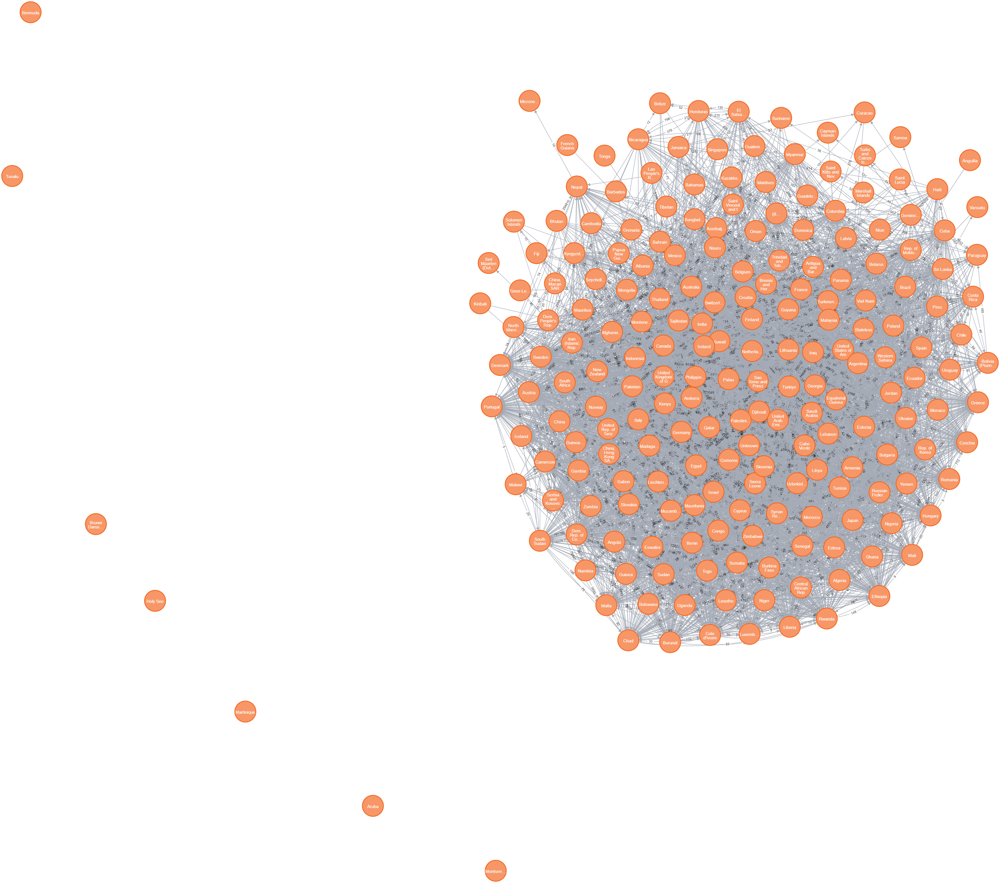

In [86]:
Image(filename='viz/countries_graph1a.png')

### Graph 1B : Continents Accepting Refugees
Create a node for each continent, with a one way relationship from the continent the refugees are <b>emigrating from</b> to the continent the refugees are <b>immigrating t</b>o, with the <b>weight of the relationship the number of refugees</b>.

In [71]:
# Query string
accept_refugees = "CREATE"

# Loop to prepare node per continent
for continent in continents:
    temp_string = "(" + continent + ":Continent {name: \"" + continent + "\"}),"
    accept_refugees = accept_refugees + temp_string

# Loop to prepare relationships between origin and arrival continents
coo_to_coa = []
for i in range(0, len(continent_gb)):
        coo_to_coa.append(
            "("
            + continent_gb.iloc[i]['coo_continent']
            + ")-[:IS_CONNECTED_TO {weight: " + str(continent_gb.iloc[i]['refugees'])
            + "}]->("
            + continent_gb.iloc[i]['coa_continent']
            + ")"
        )
accept_refugees = accept_refugees + ', '.join(coo_to_coa)

In [72]:
# Wipe out database, then load with accept refugee nodes and relationships
def my_create_graph_1b_accept_refugees():
    "create the connected graph"   
    my_neo4j_wipe_out_database()
    session.run(accept_refugees)

In [73]:
# Execute 
my_create_graph_1b_accept_refugees()

In [74]:
# Confirm that nodes and relationships were created in neo4j db
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Africa,[Continent]
1,Americas,[Continent]
2,Asia,[Continent]
3,Europe,[Continent]
4,Oceania,[Continent]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Africa,[Continent],IS_CONNECTED_TO,Americas,[Continent]
1,Africa,[Continent],IS_CONNECTED_TO,Asia,[Continent]
2,Africa,[Continent],IS_CONNECTED_TO,Europe,[Continent]
3,Africa,[Continent],IS_CONNECTED_TO,Oceania,[Continent]
4,Americas,[Continent],IS_CONNECTED_TO,Africa,[Continent]
5,Americas,[Continent],IS_CONNECTED_TO,Asia,[Continent]
6,Americas,[Continent],IS_CONNECTED_TO,Europe,[Continent]
7,Americas,[Continent],IS_CONNECTED_TO,Oceania,[Continent]
8,Asia,[Continent],IS_CONNECTED_TO,Africa,[Continent]
9,Asia,[Continent],IS_CONNECTED_TO,Americas,[Continent]


-------------------------
  Density: 2.0
-------------------------


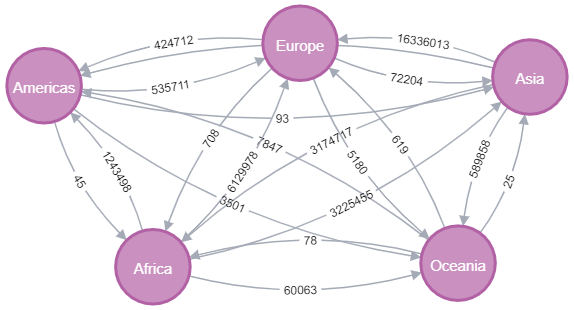

In [76]:
Image(filename='viz/continents_graph1b.png')

### Graph 2A : Countries of Origin of Refugees
Create a node for each country, with a one way relationship from the country the refugees are <b>immmigrating to</b> from the country the refugees are <b>emmigrating from</b>, with the <b>weight of the relationship the number of refugees</b>.

In [87]:
# Query string
origin_refugees = "CREATE"

# Loop to prepare node per country
for c_code, c_name in country_name_dict.items():
    temp_string = "(" + c_code + ":Country {name: \"" + c_name + "\"}),"
    origin_refugees = origin_refugees + temp_string

# NOTE: Same loop as above, but 'coo' and 'coa' are flipped
coa_to_coo = []
for i in range(0, len(country_gb)):
        coa_to_coo.append(
            "("
            + country_gb.iloc[i]['coa']
            + ")-[:IS_CONNECTED_TO {weight: " + str(country_gb.iloc[i]['refugees'])
            + "}]->("
            + country_gb.iloc[i]['coo']
            + ")"
        )

origin_refugees = origin_refugees + ', '.join(coa_to_coo)

In [88]:
# Wipe out database, then load with origin refugee nodes and relationships
def my_create_graph_2a_origin_refugees():
    "create the connected graph"
    my_neo4j_wipe_out_database()
    session.run(origin_refugees)

In [89]:
# Execute
my_create_graph_2a_origin_refugees()

In [90]:
# Confirm that nodes and relationships were created in neo4j db
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
207,Viet Nam,[Country]
208,Western Sahara,[Country]
209,Yemen,[Country]
210,Zambia,[Country]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Iran (Islamic Rep. of),[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Iraq,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Pakistan,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Türkiye,[Country]
4,Albania,[Country],IS_CONNECTED_TO,Afghanistan,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Sierra Leone,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Somalia,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,South Sudan,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,Sudan,[Country]


-------------------------
  Density: 0.3
-------------------------


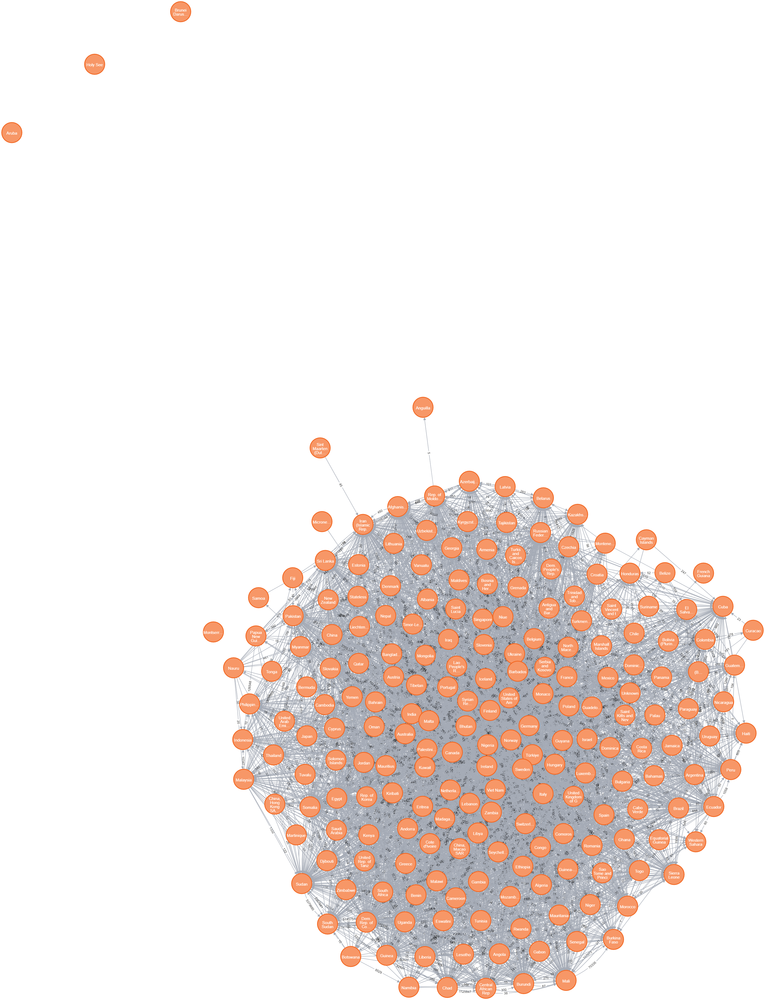

In [92]:
Image(filename='viz/countries_graph2a.png')

### Graph 2B : Contintents of Origin of Refugees
Create a node for each continent, with a one way relationship from the continent the refugees are <b>immmigrating to</b> from the continent the refugees are <b>emmigrating from</b>, with the <b>weight of the relationship the number of refugees</b>.

In [77]:
# Query string
origin_refugees = "CREATE"

# Loop to prepare node per continent
for continent in continents:
    temp_string = "(" + continent + ":Country {name: \"" + continent + "\"}),"
    origin_refugees = origin_refugees + temp_string

# NOTE: Same loop as above, but 'coo' and 'coa' are flipped
coa_to_coo = []
for i in range(0, len(continent_gb)):
        coa_to_coo.append(
            "("
            + continent_gb.iloc[i]['coa_continent']
            + ")-[:IS_CONNECTED_TO {weight: " + str(continent_gb.iloc[i]['refugees'])
            + "}]->("
            + continent_gb.iloc[i]['coo_continent']
            + ")"
        )

origin_refugees = origin_refugees + ', '.join(coa_to_coo)

In [78]:
# Wipe out database, then load with origin refugee nodes and relationships
def my_create_graph_2b_origin_refugees():
    "create the connected graph"
    my_neo4j_wipe_out_database()
    session.run(origin_refugees)

In [79]:
# Execute
my_create_graph_2b_origin_refugees()

In [80]:
# Confirm that nodes and relationships were created in neo4j db
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Africa,[Country]
1,Americas,[Country]
2,Asia,[Country]
3,Europe,[Country]
4,Oceania,[Country]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Africa,[Country],IS_CONNECTED_TO,Americas,[Country]
1,Africa,[Country],IS_CONNECTED_TO,Asia,[Country]
2,Africa,[Country],IS_CONNECTED_TO,Europe,[Country]
3,Africa,[Country],IS_CONNECTED_TO,Oceania,[Country]
4,Americas,[Country],IS_CONNECTED_TO,Africa,[Country]
5,Americas,[Country],IS_CONNECTED_TO,Asia,[Country]
6,Americas,[Country],IS_CONNECTED_TO,Europe,[Country]
7,Americas,[Country],IS_CONNECTED_TO,Oceania,[Country]
8,Asia,[Country],IS_CONNECTED_TO,Africa,[Country]
9,Asia,[Country],IS_CONNECTED_TO,Americas,[Country]


-------------------------
  Density: 2.0
-------------------------


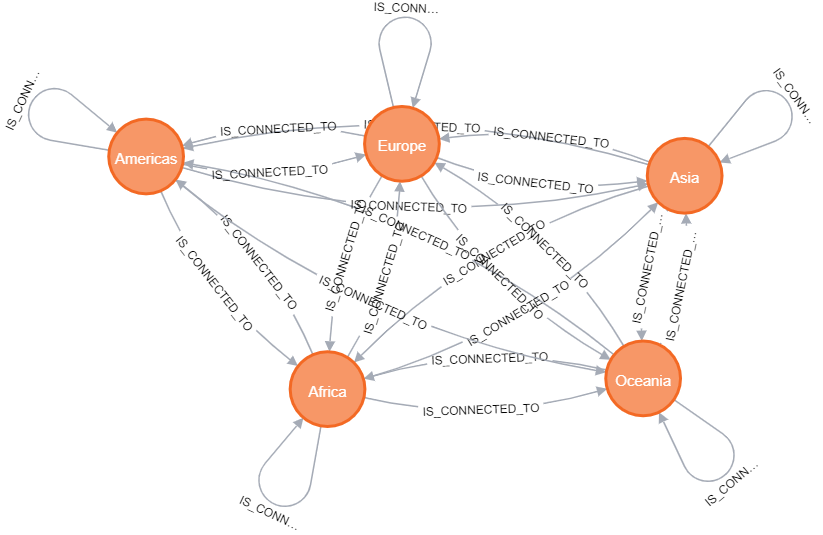

In [81]:
Image(filename='viz/continents_graph2b.png')

## PageRank -- most popular country granting asylum

In [99]:
# Double check to ensure we call the correct graph
my_create_graph_1a_accept_refugees()
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
207,Viet Nam,[Country]
208,Western Sahara,[Country]
209,Yemen,[Country]
210,Zambia,[Country]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Albania,[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Argentina,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Armenia,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Australia,[Country]
4,Afghanistan,[Country],IS_CONNECTED_TO,Austria,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Thailand,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Türkiye,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,United Kingdom of Great Britain and Northern I...,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,United States of America,[Country]


-------------------------
  Density: 0.3
-------------------------


In [100]:
# PageRank
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [101]:
query = """

CALL gds.pageRank.stream('ds_graph', {
  maxIterations: $max_iterations,
  dampingFactor: $damping_factor
})
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as page_rank
ORDER BY score DESC, name ASC
LIMIT 10

"""

max_iterations = 20
damping_factor = 0.85
my_neo4j_run_query_pandas(
    query,
    max_iterations=max_iterations,
    damping_factor=damping_factor
)

,name,page_rank
0,Canada,16.827662
1,United States of America,15.062826
2,Germany,13.543485
3,Rep. of Moldova,12.067316
4,Sweden,8.580115
5,Switzerland,7.344258
6,United Kingdom of Great Britain and Northern I...,5.961447
7,France,5.760327
8,Australia,5.540535
9,Ireland,4.597863


In [104]:
# PageRank gets different results than pure counts of asylum seekers
# E.g., Country with most asylum_seekers is USA, not Canada
top_asylum_granter = population3.groupby(['coa'])['asylum_seekers'].sum()
top_asylum_granter_df=pd.DataFrame(top_asylum_granter)
top_asylum_granter_df.sort_values(by=['asylum_seekers'], ascending=False).head(5)

,asylum_seekers
coa,
USA,7342424
GFR,3434829
RSA,3402218
TUR,2502129
PER,2372036


## The application of PageRank algorithm on first graph (coo to coa) tells us that the most influential country in granting asylum is Canada, followed by United States of America, Germany, and Republic of Moldova. 

If we only look at the sum of asylum seekers or refugees, USA has the most highest number. However, PageRank tells us the overall influence of a node in graphy, including direct and indirect influence. Apparently, Canada is connecting to more influential countries than USA.

Apparently, high number does not equal to high influence

## A little bit info about Moldova:

Moldova is an Eastern European country, bounded by Ukraine to the north, east, and south and by Romania to the west.(https://www.britannica.com/place/Moldova/People)

## Most influential countries creating refugees--PageRank

In [105]:
# Double check to ensure we call the correct graph
my_create_graph_2a_origin_refugees()
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
207,Viet Nam,[Country]
208,Western Sahara,[Country]
209,Yemen,[Country]
210,Zambia,[Country]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Iran (Islamic Rep. of),[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Iraq,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Pakistan,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Türkiye,[Country]
4,Albania,[Country],IS_CONNECTED_TO,Afghanistan,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Sierra Leone,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Somalia,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,South Sudan,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,Sudan,[Country]


-------------------------
  Density: 0.3
-------------------------


In [106]:
# PageRank
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [107]:
query = """


CALL gds.pageRank.stream('ds_graph', {
  maxIterations: $max_iterations,
  dampingFactor: $damping_factor
})
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as page_rank
ORDER BY score DESC, name ASC
LIMIT 10

"""

max_iterations = 20
damping_factor = 0.85

my_neo4j_run_query_pandas(
    query,
    max_iterations=max_iterations,
    damping_factor=damping_factor
)


,name,page_rank
0,Syrian Arab Rep.,4.753966
1,Iraq,4.661020
2,Sudan,4.592993
3,Somalia,4.564017
4,Afghanistan,4.032353
5,Ethiopia,4.022142
6,Iran (Islamic Rep. of),3.856771
7,Dem. Rep. of the Congo,3.704284
8,Pakistan,3.436547
9,Eritrea,3.423082


## The most influential country in creating refugee is Sudan, closely followed by Syrian, Iraq, and Somalia.

In [108]:
find_countries = ['CAN', 'USA']
syria_df = country_gb[country_gb['coo'] == 'SYR'].sort_values('refugees', ascending=False)
syria_df.insert(0, 'rank', range(1, 1 + len(syria_df)))
print('Total relationships:', len(syria_df))
display(syria_df.head(10))
print('Countries not in top 10 but of interest:')
for country in find_countries:
    display(syria_df[syria_df['coa'] == country])

Total relationships: 125


,rank,coo,coa,refugees,asylum_seekers
4832,1,SYR,TUR,29257140,1580
4779,2,SYR,LEB,9561936,1542
4770,3,SYR,JOR,6705304,3396
4756,4,SYR,GFR,3943021,545351
4767,5,SYR,IRQ,2486202,5933
4719,6,SYR,ARE,1318272,85
4825,7,SYR,SWE,877732,99194
4822,8,SYR,SUD,489265,1929
4723,9,SYR,AUS,394592,69064
4798,10,SYR,NET,275349,42689


Countries not in top 10 but of interest:


,rank,coo,coa,refugees,asylum_seekers
4734,33,SYR,CAN,14683,4867


,rank,coo,coa,refugees,asylum_seekers
4837,21,SYR,USA,72708,28993


## Select Top Asylum Granter, USA, show how reguees flow from the top refugee creators --Minimum Spanning Tree

In [119]:
def my_neo4j_wipe_out_mst_relationships():
    "wipe out mst relationships"
    query = "match (node)-[relationship:MST]->() delete relationship"
    session.run(query)

In [120]:
my_neo4j_wipe_out_mst_relationships()

In [121]:
my_create_graph_2a_origin_refugees()

In [122]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 
                        {
                            IS_CONNECTED_TO: {
                                properties: 'weight',
                                orientation: 'UNDIRECTED'
                            }
                        }
                       )

"""

session.run(query)

In [123]:
query = """

MATCH (n:Country {name: $source})
CALL gds.beta.spanningTree.write('ds_graph',
                                          {sourceNode: id(n),
                                           relationshipWeightProperty: 'weight',
                                           writeProperty: 'writerefugees',
                                           writeRelationshipType: 'MST'
                                          }
                                         )
YIELD preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount
RETURN preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount;

"""

source = "United States of America"

my_neo4j_run_query_pandas(query, source=source)

,preProcessingMillis,computeMillis,writeMillis,effectiveNodeCount
0,0,11,33,205


In [124]:
query = """

MATCH path = (n:Country {name: $source})-[:MST*]-()
WITH relationships(path) AS rels
UNWIND rels AS rel
WITH DISTINCT rel AS rel
RETURN startNode(rel).name AS destination, endNode(rel).name AS source, rel.writerefugees AS refugees

"""

source = "United States of America"

my_neo4j_run_query_pandas(query, source=source)

,destination,source,refugees
0,United States of America,Estonia,5.0
1,Estonia,Uzbekistan,5.0
2,Estonia,Kazakhstan,5.0
3,Estonia,Turkmenistan,5.0
4,Turkmenistan,Russian Federation,5.0
...,...,...,...
199,Afghanistan,Bosnia and Herzegovina,5.0
200,Sri Lanka,Saint Lucia,5.0
201,United States of America,Niue,183.0
202,United States of America,Guadeloupe,17.0


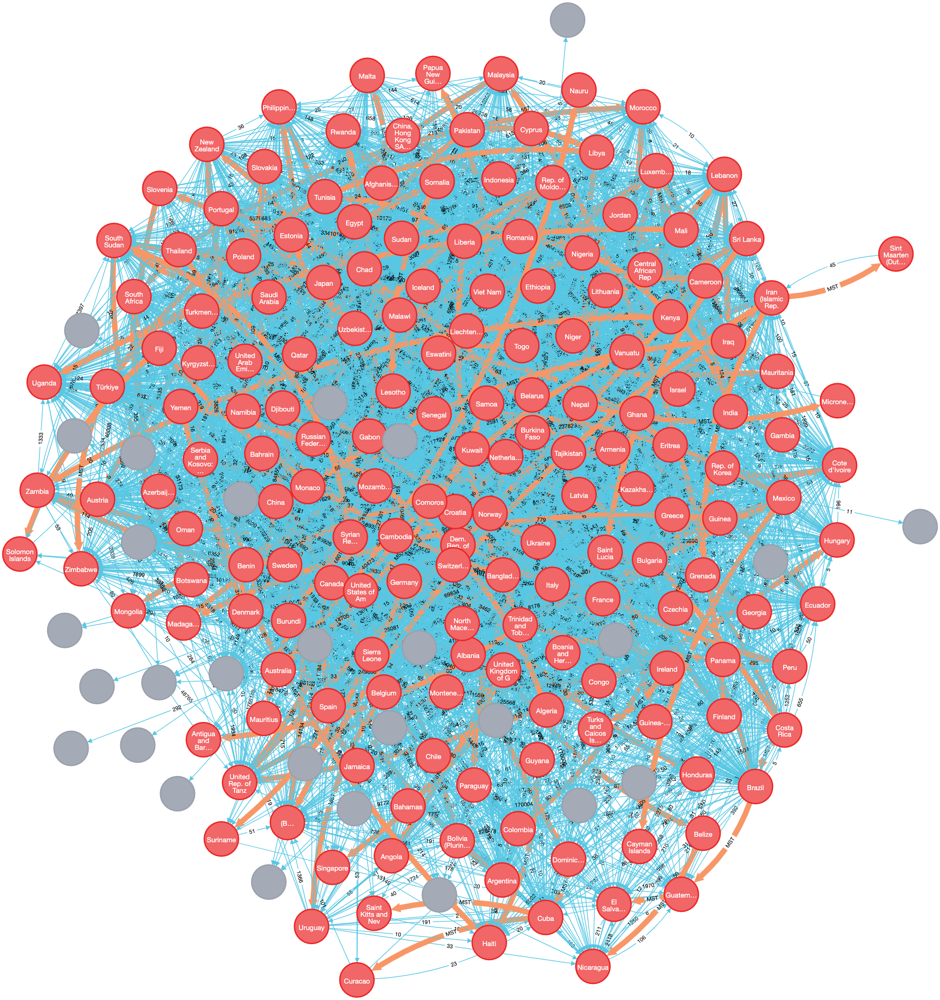

In [115]:
Image(filename='viz/USA_MST.png')

## Select top refugee creators, Syria, run Minimiing Spanning Tree on the first graph to see how refugees flow to the top asylum granters

In [125]:
def my_neo4j_wipe_out_mst_relationships():
    "wipe out mst relationships"
    
    query = "match (node)-[relationship:MST]->() delete relationship"
    session.run(query)

In [126]:
my_neo4j_wipe_out_mst_relationships()

In [127]:
my_create_graph_1a_accept_refugees()

In [128]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 
                        {
                            IS_CONNECTED_TO: {
                                properties: 'weight',
                                orientation: 'UNDIRECTED'
                            }
                        }
                       )

"""

session.run(query)

In [129]:
query = """

MATCH (n:Country {name: $source})
CALL gds.beta.spanningTree.write('ds_graph',
                                          {sourceNode: id(n),
                                           relationshipWeightProperty: 'weight',
                                           writeProperty: 'writerefugees',
                                           writeRelationshipType: 'MST'
                                          }
                                         )
YIELD preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount
RETURN preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount;

"""

source = "Syrian Arab Rep."

my_neo4j_run_query_pandas(query, source=source)

,preProcessingMillis,computeMillis,writeMillis,effectiveNodeCount
0,0,14,27,205


In [131]:
query = """

MATCH path = (n:Country {name: $source})-[:MST*]-()
WITH relationships(path) AS rels
UNWIND rels AS rel
WITH DISTINCT rel AS rel
RETURN startNode(rel).name AS source, endNode(rel).name AS destination, rel.writerefugees AS refugees

"""

source = "Syrian Arab Rep."

my_neo4j_run_query_pandas(query, source=source)

,source,destination,refugees
0,Syrian Arab Rep.,Rwanda,5.0
1,Rwanda,Yemen,5.0
2,Yemen,Haiti,5.0
3,Haiti,Guyana,5.0
4,Haiti,Uruguay,10.0
...,...,...,...
199,Syrian Arab Rep.,Mauritius,10.0
200,Syrian Arab Rep.,Mongolia,5.0
201,Syrian Arab Rep.,Bahrain,5.0
202,Bahrain,Denmark,5.0


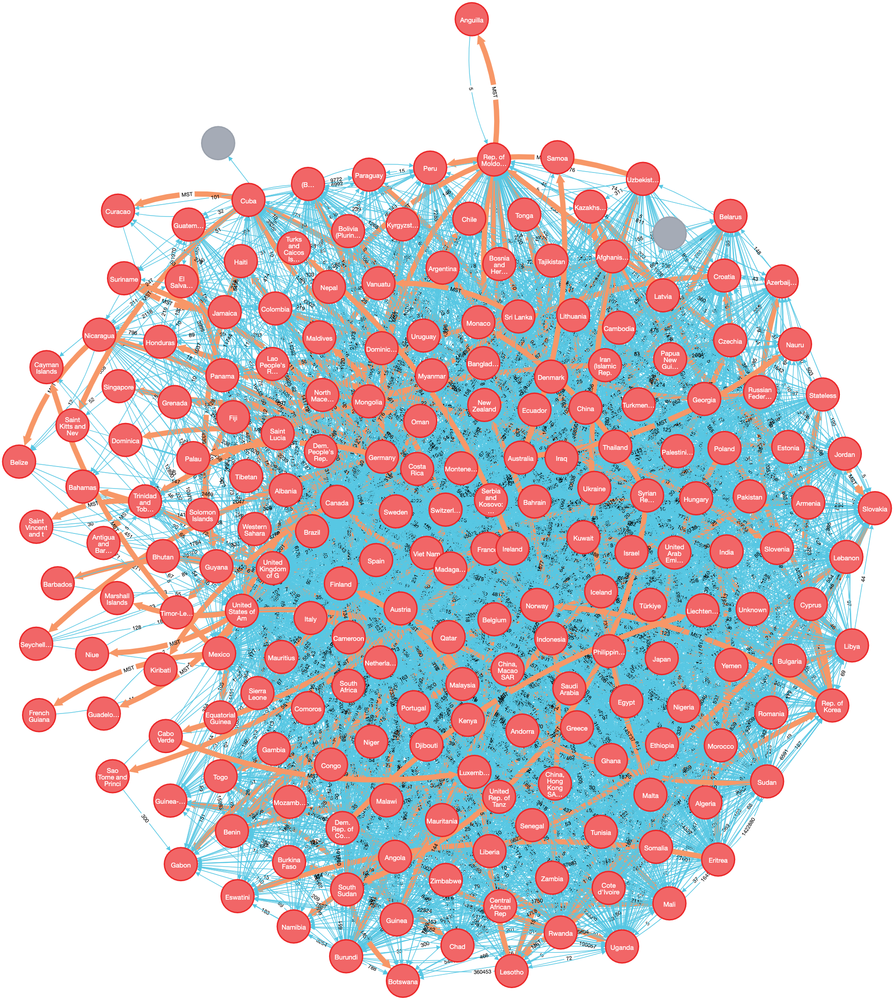

In [132]:
Image(filename='viz/SRY_MST.png')

## Shortest path would needs the coordinates of every country, is that worthy to do so? Or we could focus on telling the flow pattern of refugee?

### Degree Centrality 
swap out which graph function is commented in the next cell to switch degree centrality outputs!
- using graph 1 will show us the countries with the most creation of refugees 
- using graph 2 will show us the countries with the most grant asylum

In [135]:
my_neo4j_wipe_out_database()
my_create_graph_1a_accept_refugees()

In [136]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [137]:
query = """

CALL gds.degree.stream('ds_graph')
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as degree
ORDER BY degree DESC, name

"""

my_neo4j_run_query_pandas(query)

,name,degree
0,Syrian Arab Rep.,125.0
1,Iraq,110.0
2,Somalia,110.0
3,Dem. Rep. of the Congo,108.0
4,Sudan,103.0
...,...,...
207,Martinique,0.0
208,Micronesia (Federated States of),0.0
209,Montserrat,0.0
210,Sint Maarten (Dutch part),0.0


## By using Degree Centrality, Syrian found to be the country with the most creation of refugees, followed by Iraq, Somalia, and Congo.

In [139]:
my_neo4j_wipe_out_database()

my_create_graph_2a_origin_refugees()

In [140]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [141]:
query = """

CALL gds.degree.stream('ds_graph')
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as degree
ORDER BY degree DESC, name

"""

my_neo4j_run_query_pandas(query)

,name,degree
0,Canada,180.0
1,United States of America,180.0
2,Germany,165.0
3,United Kingdom of Great Britain and Northern I...,146.0
4,France,140.0
...,...,...
207,Timor-Leste,0.0
208,Tonga,0.0
209,Tuvalu,0.0
210,Unknown,0.0


## Canada is the country with the most asylum granted, followed by USA and Germany.

### Harmonic Centrality
swap out which graph function is commented in the next cell to switch harmonic centrality outputs!
- using graph 1 will tell us the intermediate countries with the highest volume of creating refugees
- using graph 2 will tell us the intermediate countries with the highest volume of granting asylum

In [142]:
my_neo4j_wipe_out_database()


my_create_graph_2_origin_refugees()

In [143]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [144]:
query = """

CALL gds.alpha.closeness.harmonic.stream('ds_graph', {})
YIELD nodeId, centrality
RETURN gds.util.asNode(nodeId).name AS name, centrality as closeness
ORDER BY centrality DESC

"""

my_neo4j_run_query_pandas(query)

,name,closeness
0,Syrian Arab Rep.,0.706951
1,Iraq,0.670616
2,Somalia,0.666667
3,Dem. Rep. of the Congo,0.655213
4,Sudan,0.651264
...,...,...
207,Holy See,0.000000
208,Martinique,0.000000
209,Aruba,0.000000
210,Montserrat,0.000000


## By using Harmonic Centrality, Syrian was found to be the intermediate countries with the highest volumne of refugees, followed by Iraq, Somalia, Congo, and Sudan.

In [145]:
my_neo4j_wipe_out_database()

my_create_graph_1_accept_refugees()
#my_create_graph_2_origin_refugees()

In [146]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [147]:
query = """

CALL gds.alpha.closeness.harmonic.stream('ds_graph', {})
YIELD nodeId, centrality
RETURN gds.util.asNode(nodeId).name AS name, centrality as closeness
ORDER BY centrality DESC

"""

my_neo4j_run_query_pandas(query)

,name,closeness
0,United States of America,0.905213
1,Canada,0.905213
2,Germany,0.869668
3,United Kingdom of Great Britain and Northern I...,0.823065
4,France,0.808057
...,...,...
207,Martinique,0.000000
208,Aruba,0.000000
209,Montserrat,0.000000
210,Palestinian,0.000000


## USA is the intermediate country with highest volume of asylum granted, followed by Canada and Germany.

### Louvain Modularity
with communities that physically span the sea showing sea port routes that refugees might be taking

In [148]:
my_neo4j_wipe_out_database()
my_create_graph_1a_accept_refugees()

In [149]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', 
                      {relationshipProperties: 'weight'})
"""

session.run(query)

In [150]:
query = """

CALL gds.louvain.stream('ds_graph', {includeIntermediateCommunities: true})
YIELD nodeId, communityId, intermediateCommunityIds
RETURN gds.util.asNode(nodeId).name AS name, communityId as community, intermediateCommunityIds as intermediate_community
ORDER BY community, name ASC

"""

my_neo4j_run_query_pandas(query)

,name,community,intermediate_community
0,Burundi,149,"[149, 149, 149]"
1,Central African Rep.,149,"[149, 149, 149]"
2,Chad,149,"[149, 149, 149]"
3,Fiji,149,"[149, 149, 149]"
4,Kenya,149,"[149, 149, 149]"
...,...,...,...
207,Viet Nam,186,"[103, 176, 186]"
208,Western Sahara,186,"[103, 176, 186]"
209,Yemen,186,"[103, 176, 186]"
210,Zambia,186,"[103, 176, 186]"


In [151]:
test=pd.DataFrame(my_neo4j_run_query_pandas(query))
test[test['name']=='Syrian Arab Rep.']

,name,community,intermediate_community
184,Syrian Arab Rep.,186,"[103, 149, 176, 186]"


In [152]:
test[test['community']==118].head(25)

,name,community,intermediate_community


In [153]:
test[test['community']==176].head(25)

,name,community,intermediate_community


In [154]:
test[test['community']==130].head(25)

,name,community,intermediate_community


In [155]:
test['community'].unique()

array([161, 169, 175, 180, 183, 184, 185, 186])

In [156]:
population[population['coo'] == 'SYR']['coa'].unique()

array(['ARE', 'AUL', 'AUS', 'BEL', 'BRA', 'BUL', 'CAN', 'CYP', 'CZE',
       'DEN', 'ECU', 'FIN', 'FRA', 'GBR', 'GFR', 'GRE', 'HRV', 'HUN',
       'IRE', 'IRQ', 'ITA', 'JOR', 'KGZ', 'KUW', 'LEB', 'LTU', 'LUX',
       'MAC', 'MDA', 'MLS', 'MTA', 'NET', 'NOR', 'NZL', 'OMN', 'PAK',
       'POL', 'QAT', 'ROM', 'RUS', 'SAU', 'SPA', 'SVK', 'SWE', 'SWI',
       'TUN', 'TUR', 'UAE', 'UKR', 'USA', 'YEM', 'ALG', 'ARM', 'BAH',
       'CHD', 'INS', 'LVA', 'MOR', 'SVN', 'THA', 'ALB', 'ARG', 'AZE',
       'BLR', 'BSN', 'CHL', 'CMR', 'CUB', 'DOM', 'GEO', 'IND', 'JPN',
       'KAZ', 'KOR', 'LBY', 'MNE', 'NGR', 'PHI', 'POR', 'RSA', 'SRB',
       'SUD', 'SYR', 'TOG', 'BOL', 'COS', 'EST', 'GHA', 'ICE', 'ICO',
       'LBR', 'MAU', 'MCD', 'MEX', 'MNG', 'NIG', 'PER', 'SEN', 'SOM',
       'TAN', 'UGA', 'ZAM', 'CAR', 'CHI', 'COL', 'DJB', 'ETH', 'JAM',
       'KEN', 'LIE', 'LKA', 'MLI', 'NRU', 'PAR', 'TRT', 'URU', 'ANT',
       'COB', 'COD', 'SAL', 'ZIM', 'CUW', 'SXM', 'BEN', 'GNB', 'MTS',
       'SSD', 'VEN',

### Louvain Modularity
+ Run on only the countries that accepted refugees from Syria directly (#A)
+ Run only first few years 2011-2015 (2011-2013 maybe?) onwards on ALL countries
+ If necessary, drop to only one year
+ Run only years 2011 onwards (#A)

In [168]:
my_neo4j_wipe_out_database()
# my_create_graph_1b_accept_refugees()
# my_create_graph_2b_origin_refugees()
my_create_graph_1b_accept_refugees()

In [164]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Continent', 'IS_CONNECTED_TO', 
                      {relationshipProperties: 'weight'})
"""

session.run(query)

In [165]:
query = """

CALL gds.louvain.stream('ds_graph', {includeIntermediateCommunities: true})
YIELD nodeId, communityId, intermediateCommunityIds
RETURN gds.util.asNode(nodeId).name AS name, communityId as community, intermediateCommunityIds as intermediate_community
ORDER BY community, name ASC

"""

my_neo4j_run_query_pandas(query)

,name,community,intermediate_community


In [166]:
test = pd.DataFrame(my_neo4j_run_query_pandas(query))
test[test['name']=='Syrian Arab Rep.']

,name,community,intermediate_community


### Graph 1C : Countries Accepting Refugees (2011-2015)
Create a node for each country, with a one way relationship from the country the refugees are <b>emigrating from</b> to the country the refugees are <b>immigrating t</b>o, with the <b>weight of the relationship the number of refugees</b>.

In [171]:
# Query string
accept_refugees = "CREATE"

# Loop to prepare node per country
for c_code, c_name in country_name_dict.items():
    temp_string = "(" + c_code + ":Country {name: \"" + c_name + "\"}),"
    accept_refugees = accept_refugees + temp_string

# Loop to prepare relationships between origin and arrival countries
coo_to_coa = []
for i in range(0, len(country_gb2)):
        coo_to_coa.append(
            "("
            + country_gb2.iloc[i]['coo']
            + ")-[:IS_CONNECTED_TO {weight: " + str(country_gb2.iloc[i]['refugees'])
            + "}]->("
            + country_gb2.iloc[i]['coa']
            + ")"
        )
accept_refugees = accept_refugees + ', '.join(coo_to_coa)

In [172]:
# Wipe out database, then load with accept refugee nodes and relationships
def my_create_graph_1c_accept_refugees():
    "create the connected graph"   
    my_neo4j_wipe_out_database()
    session.run(accept_refugees)

In [173]:
# Execute 
my_create_graph_1c_accept_refugees()

In [174]:
# Confirm that nodes and relationships were created in neo4j db
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
207,Viet Nam,[Country]
208,Western Sahara,[Country]
209,Yemen,[Country]
210,Zambia,[Country]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Argentina,[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Australia,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Austria,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Azerbaijan,[Country]
4,Afghanistan,[Country],IS_CONNECTED_TO,Belarus,[Country]
...,...,...,...,...,...
4389,Zimbabwe,[Country],IS_CONNECTED_TO,Sweden,[Country]
4390,Zimbabwe,[Country],IS_CONNECTED_TO,Switzerland,[Country]
4391,Zimbabwe,[Country],IS_CONNECTED_TO,United Kingdom of Great Britain and Northern I...,[Country]
4392,Zimbabwe,[Country],IS_CONNECTED_TO,United States of America,[Country]


-------------------------
  Density: 0.2
-------------------------


In [175]:
# my_neo4j_wipe_out_database()
# my_create_graph_1c_accept_refugees()

In [176]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', 
                      {relationshipProperties: 'weight'})
"""

session.run(query)

In [177]:
query = """

CALL gds.louvain.stream('ds_graph', {includeIntermediateCommunities: true})
YIELD nodeId, communityId, intermediateCommunityIds
RETURN gds.util.asNode(nodeId).name AS name, communityId as community, intermediateCommunityIds as intermediate_community
ORDER BY community, name ASC

"""

my_neo4j_run_query_pandas(query)

,name,community,intermediate_community
0,Bermuda,161,"[161, 161, 161, 161, 161, 161]"
1,Samoa,168,"[168, 168, 168, 168, 168, 168]"
2,Tuvalu,169,"[169, 169, 169, 169, 169, 169]"
3,Palau,170,"[170, 170, 170, 170, 170, 170]"
4,Guadeloupe,174,"[174, 174, 174, 174, 174, 174]"
...,...,...,...
207,Viet Nam,186,"[65, 181, 159, 165, 176, 186]"
208,Western Sahara,186,"[149, 181, 159, 165, 176, 186]"
209,Yemen,186,"[65, 181, 159, 165, 176, 186]"
210,Zambia,186,"[65, 181, 159, 165, 176, 186]"


In [178]:
test = pd.DataFrame(my_neo4j_run_query_pandas(query))
test[test['name']=='Syrian Arab Rep.']

,name,community,intermediate_community
185,Syrian Arab Rep.,186,"[65, 181, 159, 165, 176, 186]"


In [183]:
test['community'].value_counts()

186    199
161      1
168      1
169      1
170      1
174      1
175      1
177      1
178      1
180      1
182      1
183      1
184      1
185      1
Name: community, dtype: int64

In [179]:
test['community'].unique()

array([161, 168, 169, 170, 174, 175, 177, 178, 180, 182, 183, 184, 185,
       186])

In [182]:
test[test['community'] == 161].head(40)

,name,community,intermediate_community
0,Bermuda,161,"[161, 161, 161, 161, 161, 161]"


In [181]:
test[test['community'] == 186].head(40)

,name,community,intermediate_community
13,Afghanistan,186,"[65, 181, 159, 165, 176, 186]"
14,Albania,186,"[65, 181, 159, 165, 176, 186]"
15,Algeria,186,"[65, 181, 159, 165, 176, 186]"
16,Andorra,186,"[149, 181, 159, 165, 176, 186]"
17,Angola,186,"[65, 181, 159, 165, 176, 186]"
18,Antigua and Barbuda,186,"[65, 181, 159, 165, 176, 186]"
19,Argentina,186,"[65, 181, 159, 165, 176, 186]"
20,Armenia,186,"[65, 181, 159, 165, 176, 186]"
21,Australia,186,"[65, 181, 159, 165, 176, 186]"
22,Austria,186,"[149, 181, 159, 165, 176, 186]"
